If you are running on Google Colab, you can run directly the cells below. Otherwise the requirements are the same as for the Reinforcement Learning Labs. The first cells would simply not execute.

In [1]:
import sys, subprocess

def is_colab():
    return "google.colab" in sys.modules

In [2]:
colab_requirements = [
    "gym",
    "numpy",
    "pandas",
    "seaborn",
    "pyvirtualdisplay",
    "imageio",
    "nnfigs",
    "box2d-py"
]

debian_packages = [
    "xvfb",
    "x11-utils"
]

if is_colab():

    def run_subprocess_command(cmd):
        # run the command
        process = subprocess.Popen(cmd.split(), stdout=subprocess.PIPE)
        # print the output
        for line in process.stdout:
            print(line.decode().strip())

    for i in colab_requirements:
        run_subprocess_command("pip install " + i)

    for i in debian_packages:
        run_subprocess_command("apt install " + i)

In [3]:
import gym
import numpy as np
from scipy.special import softmax

%matplotlib inline

import matplotlib
import matplotlib.pyplot as plt

import math
import gym
import numpy as np
import copy
import pandas as pd
import seaborn as sns
import time
import imageio
import IPython
from IPython.display import Image

In [4]:
if "google.colab" in sys.modules:
    import pyvirtualdisplay

    _display = pyvirtualdisplay.Display(visible=False,  # use False with Xvfb
                                        size=(1400, 900))
    _ = _display.start()

In [5]:
class RenderWrapper:
    def __init__(self, env, force_gif=False):
        self.env = env
        self.force_gif = force_gif
        self.reset()

    def reset(self):
        self.images = []

    def render(self):
        if not is_colab():
            self.env.render()
            time.sleep(1./60.)

        if is_colab() or self.force_gif:
            img = self.env.render(mode='rgb_array')
            self.images.append(img)

    def make_gif(self, filename="render"):
        if is_colab() or self.force_gif:
            imageio.mimsave(filename + '.gif', [np.array(img) for i, img in enumerate(self.images) if i%2 == 0], fps=29)
            return Image(open(filename + '.gif','rb').read())

    @classmethod
    def register(cls, env, force_gif=False):
        env.render_wrapper = cls(env, force_gif=True)

In [7]:
def xavier_init(n_in, n_out, layer=1):
    #return np.random.normal(0, 1/(n_in**(layer - 1)), size = (n_in, n_out))
    glorot = 1.0*np.sqrt(6.0/(n_in+n_out))
    return np.random.uniform(-glorot,glorot,size=(n_in,n_out))    

In [8]:
class Agent():
    
    def __init__(self, n_input, n_hidden, n_hidden2, n_output, mu_prob):
        
        self.n_input = n_input
        self.n_hidden = n_hidden
        self.n_hidden2 = n_hidden2
        self.n_output = n_output
        self.mu_prob = mu_prob
        self.network = {'Layer 1' : xavier_init(n_input, n_hidden , layer = 1),
                        'Bias 1'  : np.zeros((1,n_hidden)),
                        'Layer 2' : xavier_init(n_hidden, n_hidden2 , layer = 2),
                        'Bias 2'  : np.zeros((1,n_hidden2)),
                        'Layer 3': xavier_init(n_hidden2, n_output , layer = 3),
                        'Bias 3': np.zeros((1, n_output))}
        self.score = 0

    def reborn(self, parents):
        #The agent reborns with a recombination of its parents parameters
        parent1, parent2 = parents
        for key in self.network:
            mask = np.random.choice([0,1],size=self.network[key].shape,p=[.5,.5])
            self.network[key] = np.where(mask==1,parent1.network[key],parent2.network[key])
            #if np.random.random() > 0.5:
            #    self.network[node] = parent1.network[node]
            #else:
            #    self.network[node] = parent2.network[node]
                
    def mutate(self):
        for key in self.network:
            mask = np.random.choice([0,1],size=self.network[key].shape,p=[1-self.mu_prob,self.mu_prob])
            random = xavier_init(mask.shape[0],mask.shape[1])
            self.network[key] = np.where(mask==1,self.network[key]+random,self.network[key])
            #if np.random.random() > self.mu_prob:
            #    self.network[node] += np.random.normal(0, 0.05 * np.abs(self.network[node]) )
                #if np.argwhere(np.isnan(self.network[node])):
                #    print("nanNode")
    
    def act(self, state):
        if(state.shape[0] != 1):
            state = state.reshape(1,-1)
        net = self.network
        layer_one = np.tanh(np.dot(state,net['Layer 1']) + net['Bias 1'])
        layer_two = np.tanh(np.dot(layer_one, net['Layer 2']) + net['Bias 2'])
        layer_three = np.tanh(np.dot(layer_two, net['Layer 3']) + net['Bias 3'])
        #print(layer_two, layer_two[0])
        return layer_three[0]

        
    def evaluate(self, env):
        scores = []
        for i in range(2):
            state = env.reset()
            score = 0
            done = False
            while not done:
                state, reward, done, _ = env.step(self.act(state))
                score += reward
            #print(score)
            scores.append(score)
        self.score = sum(scores)/2
        #print(self.score)

In [9]:
def select_next_gen(agent_set,n_selected):
    n_best = int(n_selected*0.8)
    n_random = n_selected - n_best
    sorted_agents = sorted(agent_set, key = lambda agent : agent.score, reverse = True)
    #for agent in sorted_agents:
     #   print(agent.score)
    next_gen = sorted_agents[:n_best]
    next_random = np.random.choice(sorted_agents, size = n_random, replace = False)
    for rand in next_random:
        next_gen.append(rand)
    not_selected = []
    for agent in agent_set:
        #print(next_gen)
        #print("ee")
        if agent not in next_gen:
            not_selected.append(agent)
    return sorted_agents[0], next_gen, not_selected

def select_parents(agent_set):
    return np.random.choice(agent_set, size = 2, p = softmax([agent.score for agent in agent_set]))

In [10]:
env = gym.make('BipedalWalker-v3')
#RenderWrapper.register(env, force_gif=True)

done = False



#Algorithm parameter
n_input = env.observation_space.shape[0]
n_output = env.action_space.shape[0]
n_hidden = 128
n_hidden2 = 64

mu_prob = 0.10
generation = 100
population = 80

prop_selected = 0.3


/Users/utilisateur/opt/anaconda3/lib/python3.7/site-packages/gym/logger.py:30: UserWarning: WARN: Box bound precision lowered by casting to float32
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))


The next two cells import the best performing agent that is saved in the file best_agent.dill and then we display the gif showing the agent walking.

In [13]:
## TO OPEN directly the best performing agent saved
import dill
with open('best_agent.dill', 'rb') as fp:
    best_agent = dill.load(fp)

In [14]:
# Record every agent
env = gym.make('BipedalWalker-v3')
RenderWrapper.register(env, force_gif=True)

observation = env.reset()
done = False


#for agent in best[generation - 5:generation -1]:
observation = env.reset()
for t in range(3000):
    env.render_wrapper.render()

    observation, reward, done, info = env.step(best_agent.act(observation))


print()
env.close()

env.render_wrapper.make_gif("Evolution")

KeyboardInterrupt: 

In [ ]:
n_selected = int(prop_selected * population)
best_agents = []
agent_set = [Agent(n_input, n_hidden, n_hidden2, n_output, mu_prob) for i in range(population)]
best, selected, next_children = select_next_gen(agent_set, n_selected)

best_agents.append(best)
score_evolution = []
time_evolution = []

for gen in range(1, generation):
    time_gen1 = time.time()
    for new_child in next_children:
        #time1 = time.time()
        parents = select_parents(selected)
        #time2 = time.time()
        #print("Time for select_parents:", time2-time1)
        new_child.reborn(parents)
        #time3 = time.time()
        #print("Time reborn:", time3-time2)
        new_child.mutate()
        #time4 = time.time()
        #print("Time for mutate:", time4 -time3)
        #new_child.evaluate(env)
        #time5 = time.time()
        #print("Time for evaluate:", time5-time4)
    for agent in agent_set:
        agent.evaluate(env)
    best, selected, next_children = select_next_gen(agent_set, n_selected)
    best_agents.append(best)
    time_gen2 = time.time()
    print("Generation:",gen,"Score:",best.score)
    score_evolution.append(best.score)
    time_evolution.append(time_gen2 - time_gen1)
    print("Time for generation:", time_gen2 - time_gen1)

Generation: 1 Score: -32.16325525511283
Time for generation: 58.81775999069214
Generation: 2 Score: -24.490177571165724
Time for generation: 74.67573404312134
Generation: 3 Score: -23.649228420121062
Time for generation: 122.42723202705383
Generation: 4 Score: -24.646276032045837
Time for generation: 112.2429850101471
Generation: 5 Score: -20.940019528094737
Time for generation: 98.45353603363037
Generation: 6 Score: -23.649304531265756
Time for generation: 108.11398196220398
Generation: 7 Score: -26.128104486934998
Time for generation: 97.95784592628479
Generation: 8 Score: -22.86274759954422
Time for generation: 95.72181510925293
Generation: 9 Score: -15.040639945959747
Time for generation: 85.42976999282837
Generation: 10 Score: -7.941826977812953
Time for generation: 84.70026683807373
Generation: 11 Score: -9.680244882939029
Time for generation: 102.57664489746094
Generation: 12 Score: -8.730246352882878
Time for generation: 124.90411400794983
Generation: 13 Score: -7.1208877450051

In [ ]:
#import dill
#best_agent = best_agents[-1]
#with open('best_agent.dill', 'wb') as fp:
#    dill.dump(best_agent, fp)

In [ ]:
## TO OPEN directly the best performing agent

#with open('best_agent.dill', 'rb') as fp:
#    best_agent = dill.load(fp)

/usr/local/lib/python3.7/dist-packages/gym/logger.py:30: UserWarning: WARN: Box bound precision lowered by casting to float32
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))


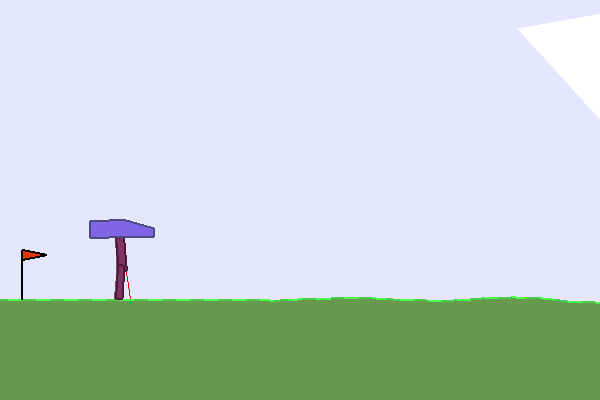

In [ ]:
# Record every agent
env = gym.make('BipedalWalker-v3')
RenderWrapper.register(env, force_gif=True)

observation = env.reset()
done = False


#for agent in best[generation - 5:generation -1]:
observation = env.reset()
for t in range(3000):
    env.render_wrapper.render()
    observation, reward, done, info = env.step(best_agent.act(observation))

print()
env.close()

env.render_wrapper.make_gif("Evolution")

In [ ]:
def evolution(mu_prob, generation, population, prop_selected, hardcore=False, n_hidden = 128, n_hidden2 = 64):

  if hardcore:
    env = gym.make('BipedalWalkerHardcore-v3')
  else:
    env = gym.make('BipedalWalker-v3')
  
  n_input = env.observation_space.shape[0]
  n_output = env.action_space.shape[0]
  done = False

  n_selected = int(prop_selected * population)
  best_agents = []
  best_scores = []
  agent_set = [Agent(n_input, n_hidden,n_hidden2, n_output, mu_prob) for i in range(population)]
  best, selected, next_children = select_next_gen(agent_set, n_selected)

  best_agents.append(best)
  total_time = 0
  for gen in range(1, generation):
    best, selected, next_children = generation_evolution(gen, next_children, selected, agent_set, env, n_selected)
    best_agents.append(best)
    best_scores.append(best.score)
  return best_agents, best_scores, total_time/generation

def generation_evolution(gen, next_children, selected, agent_set, env, n_selected):
  time_gen1 = time.time()
  for new_child in next_children:
      #time1 = time.time()
      parents = select_parents(selected)
      #time2 = time.time()
      #print("Time for select_parents:", time2-time1)
      new_child.reborn(parents)
      #time3 = time.time()
      #print("Time reborn:", time3-time2)
      new_child.mutate()
      #time4 = time.time()
      #print("Time for mutate:", time4 -time3)
  for agent in agent_set:
      agent.evaluate(env)
  best, selected, next_children = select_next_gen(agent_set, n_selected)
  time_gen2 = time.time()
  print("Generation:",gen,"Score:",best.score)
  print("Time for generation:", time_gen2 - time_gen1)
  return best, selected, next_children

  


In [ ]:
n_hidden = 64
n_hidden2 = 64

mu_prob = 0.20
generation = 80
population = 60

prop_selected = 0.3

best_agents, best_scores, time_taken = evolution(mu_prob, generation, population, prop_selected, False, n_hidden, n_hidden2)

/usr/local/lib/python3.7/dist-packages/gym/logger.py:30: UserWarning: WARN: Box bound precision lowered by casting to float32
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))


Generation: 1 Score: -57.345868799369654
Time for generation: 1.9718620777130127
Generation: 2 Score: -90.34581906331083
Time for generation: 6.173841714859009
Generation: 3 Score: -92.93869453919159
Time for generation: 3.2378199100494385
Generation: 4 Score: -106.02046524931944
Time for generation: 2.6470224857330322
Generation: 5 Score: -106.04156261402551
Time for generation: 3.361557722091675
Generation: 6 Score: -78.66958828581055
Time for generation: 7.3239264488220215
Generation: 7 Score: -100.35698324370517
Time for generation: 3.994590997695923
Generation: 8 Score: -109.96122850907847
Time for generation: 6.230916261672974
Generation: 9 Score: -110.98444666141883
Time for generation: 3.161095142364502
Generation: 10 Score: -113.53190661724254
Time for generation: 3.1826014518737793
Generation: 11 Score: -101.3930906522696
Time for generation: 0.356046199798584
Generation: 12 Score: -100.66128722701356
Time for generation: 0.3954777717590332
Generation: 13 Score: -102.13377617

KeyboardInterrupt: ignored

In [ ]:
population = 50
generation = 50
n_hidden = 128
n_hidden2 = 128
mu_prob_list = np.linspace(0.1, 0.3, 5)
prop_selected_list = [0.2, 0.3, 0.4]

scores_mu = {}
agents_mu = {}
times_mu = {}
for mu in mu_prob_list:
  best_agents, best_scores, time_taken = evolution(mu, generation, population, 0.3, False, n_hidden, n_hidden2)
  scores_mu[mu] = best_scores
  agents_mu[mu] = best_agents
  times_mu[mu] = time_taken

/usr/local/lib/python3.7/dist-packages/gym/logger.py:30: UserWarning: WARN: Box bound precision lowered by casting to float32
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))


Generation: 1 Score: -26.012070914828676
Time for generation: 45.719643354415894
Generation: 2 Score: -22.140997201401284
Time for generation: 77.50683760643005
Generation: 3 Score: -17.590946861451876
Time for generation: 83.48322439193726
Generation: 4 Score: -16.81438464667235
Time for generation: 78.34407091140747
Generation: 5 Score: -17.532696111247592
Time for generation: 65.13500881195068
Generation: 6 Score: -16.174575682382475
Time for generation: 74.95878887176514
Generation: 7 Score: -13.400848802074137
Time for generation: 65.92294049263
Generation: 8 Score: -15.903942405267024
Time for generation: 78.10883688926697
Generation: 9 Score: -15.921274633337632
Time for generation: 69.12799119949341
Generation: 10 Score: -16.141752269999785
Time for generation: 75.38724493980408
Generation: 11 Score: -17.45038822471218
Time for generation: 71.37165999412537
Generation: 12 Score: -16.293316681650744
Time for generation: 75.35512638092041
Generation: 13 Score: -16.018322755365578

[-26.012070914828676, -22.140997201401284, -17.590946861451876, -16.81438464667235, -17.532696111247592, -16.174575682382475, -13.400848802074137, -15.903942405267024, -15.921274633337632, -16.141752269999785, -17.45038822471218, -16.293316681650744, -16.018322755365578, -11.3953729360641, -8.35312949564236, -16.29325457711775, -7.224661701188085, -16.539555219809174, -9.724465898393003, -7.1579630737144, -8.122542627783494, -9.482255331169632, -7.425818228156812, -6.921094803965437, -16.846084430220674, -16.127267470066602, -6.607267138350473, -5.795854767698688, -11.770748849030058, -16.265586848332564, -11.8224721213963, -8.607255581670639, -6.579507881075452, -5.583132942342127, -7.212301724279449, -11.097438671932368, -11.359271671083775, -7.44857431233881, -7.533033462809909, -6.874851268950279, -11.690056398872004, -8.243208721268527, -6.4119838669743565, 23.49267211629219, 91.61034887396414, 63.858606045266725, 190.0568498028711, 48.52964446012567, 135.82074046102915]
[-24.4174

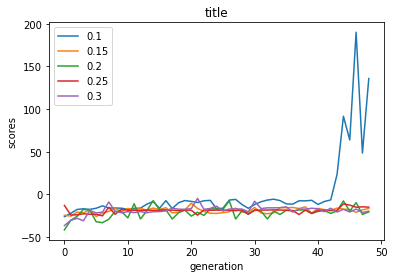

In [ ]:
import matplotlib.pyplot as plt
plt.figure()
for mu in scores_mu:
  mu_score = scores_mu[mu]
  print(mu_score)
  plt.plot(range(len(mu_score)), mu_score, label=str(mu))
  plt.title('title')
  plt.ylabel('scores')
  plt.xlabel('generation')
  plt.legend()
plt.show()

In [ ]:
scores_prop = {}
agents_prop = {}
times_prop = {}
for prop in prop_selected_list:
  best_agents, best_scores, time_taken = evolution(0.1, generation, population, prop, False, n_hidden, n_hidden2)
  scores_prop[prop] = best_scores
  agents_prop[prop] = best_agents
  times_prop[prop] = time_taken

/usr/local/lib/python3.7/dist-packages/gym/logger.py:30: UserWarning: WARN: Box bound precision lowered by casting to float32
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))


Generation: 1 Score: -29.76189049890904
Time for generation: 50.98894190788269
Generation: 2 Score: -22.121646947944924
Time for generation: 56.93347501754761
Generation: 3 Score: -20.638792532396913
Time for generation: 48.98449945449829
Generation: 4 Score: -19.945473148684115
Time for generation: 82.4509060382843
Generation: 5 Score: -19.086030737582405
Time for generation: 52.292794704437256
Generation: 6 Score: -18.717974419075635
Time for generation: 59.33180785179138
Generation: 7 Score: -20.282390134533227
Time for generation: 60.14172148704529
Generation: 8 Score: -28.229054768875272
Time for generation: 86.00793743133545
Generation: 9 Score: -20.193975226358805
Time for generation: 79.6536614894867
Generation: 10 Score: -27.943905386023808
Time for generation: 80.60738515853882
Generation: 11 Score: -20.247293380514833
Time for generation: 83.96393156051636
Generation: 12 Score: -20.366386904678286
Time for generation: 84.55640149116516
Generation: 13 Score: -20.7143716874279

[-29.76189049890904, -22.121646947944924, -20.638792532396913, -19.945473148684115, -19.086030737582405, -18.717974419075635, -20.282390134533227, -28.229054768875272, -20.193975226358805, -27.943905386023808, -20.247293380514833, -20.366386904678286, -20.714371687427956, -20.32213266155143, -20.31174854067237, -17.485457865902934, -16.9405544770255, -17.032334871880174, -8.247145267472085, -8.881702401696508, -14.217983785369979, -16.89019388776287, -13.865549998109547, -14.41713852634663, -13.284954275321905, -13.881561952997345, -14.115641869033691, -7.300552316747455, -9.750463440489332, -12.80630541961138, -6.903164179397711, -12.579142737657566, -12.212509256185601, -12.823966837469866, -12.695522051886751, -12.80494019645023, -12.833658602793367, -12.969618450497654, -12.937604116457535, -12.887324467496576, -13.232253306596338, -11.513432925227171, -12.904270865977375, -12.796810880979162, -13.244818241532831, -12.812647179711178, -13.18276440155362, -13.23886117385603, -13.139

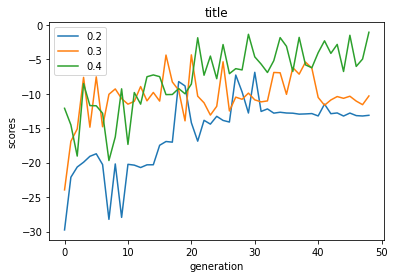

In [ ]:
import matplotlib.pyplot as plt
plt.figure()
for mu in scores_prop:
  mu_score = scores_prop[mu]
  print(mu_score)
  plt.plot(range(len(mu_score)), mu_score, label=str(mu))
  plt.title('title')
  plt.ylabel('scores')
  plt.xlabel('generation')
  plt.legend()
plt.show()

In [ ]:
best_agents, best_scores, time_taken = evolution(0.11, 60, 100, 0.3)

/usr/local/lib/python3.7/dist-packages/gym/logger.py:30: UserWarning: WARN: Box bound precision lowered by casting to float32
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))


Generation: 1 Score: -19.027235102519214
Time for generation: 56.64443302154541
Generation: 2 Score: -15.634300535518712
Time for generation: 87.9894688129425
Generation: 3 Score: -13.622944221984941
Time for generation: 89.4206805229187
Generation: 4 Score: -13.565538602182745
Time for generation: 72.2351462841034
Generation: 5 Score: -14.054116414367062
Time for generation: 71.50831198692322
Generation: 6 Score: -14.339113074829282
Time for generation: 75.30579566955566
Generation: 7 Score: -13.8307240010171
Time for generation: 74.12381672859192
Generation: 8 Score: -9.056005985470899
Time for generation: 75.18379807472229
Generation: 9 Score: -13.286542465631673
Time for generation: 78.03926396369934
Generation: 10 Score: -12.679883960424561
Time for generation: 73.99239325523376
Generation: 11 Score: -10.192492838540534
Time for generation: 76.21924948692322
Generation: 12 Score: -13.713339342883097
Time for generation: 88.71775817871094
Generation: 13 Score: -12.211750288899154
T